# 3. Via 2.0 Cartography on Zebrahub (Visualization)
This tutorial focuses on how to generate the Via2.0 Zebrahub Atlas View. The TI analysis is shown in Tutorial #2  

In [61]:
import scanpy as sc
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import core_working_rw2 as via
from datetime import datetime

### Load the data

Data has been filtered and library normalized. 
Data is annotated with time/stage, cluster labels, and cell type labels (coarse and fine)


In [62]:
print(f'{datetime.now()}\tStart reading data')
adata=sc.read_h5ad( filename='/home/user/Trajectory/Datasets/Zebrafish_Lange2023/Rawdata/Zebrahub_data_via.h5ad')
#compute PCA
adata.uns['log1p']['base'] = None #fix for small bug in scanpy #see https://github.com/theislab/single-cell-tutorial/issues/97
sc.pp.highly_variable_genes(adata, n_top_genes=2000)
sc.tl.pca(adata, n_comps=100)
print(adata)

2023-09-22 07:53:26.065783	Start reading data
AnnData object with n_obs × n_vars = 119457 × 28187
    obs: 'n_genes', 'n_counts', 'fish', 'timepoint_cluster', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_nc', 'pct_counts_nc', 'developmental_stage', 'timepoint', 'zebrafish_anatomy_ontology_class', 'zebrafish_anatomy_ontology_id', 'parc', 'kmeans50', 'celltype_extrainfo', 'zebrafish_anatomy_ontology_class_shobi', 'adjusted_timepoint', 'bool_list', 'global annotation', 'time_coarse_cell_type', 'time_fine_cell_type', 'parc_cluster', 'parc_cluster_and_cell_type'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'nc', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'global_annotation_colors', 'hvg', 'log1p', 'pca', 'timepoint_colors', 'zebrafish_anatomy_ontology_class_colors', 'zebrafish_anatomy_ontology_id_colors'
    obsm: 'X_U', 'X_Vi

### Extract some annotations

In [63]:
n_cells = adata.shape[0]
print('cells is', n_cells)
parc_cluster = [i for i in adata.obs['parc_cluster']]
parc_cluster_and_cell_type = [i for i in adata.obs['parc_cluster_and_cell_type']]
coarse_cell_type = [i for i in adata.obs['zebrafish_anatomy_ontology_class']]
fine_cell_type = [i for i in adata.obs['zebrafish_anatomy_ontology_class_shobi']] #consolidated annotaions from individual time point files
coarse_fine_cell_type = [coarse_cell_type[i] + fine_cell_type[i] for i in range(n_cells)]
time_point_numeric = [i for i in adata.obs['adjusted_timepoint']] #assigned a numeric value to each stage (e.g. 5hpf is 5, 10hpf is 10,...)
early_cell_type = [i if str(i) != 'nan' else '' for i in adata.obs['global annotation']]

hybrid_cell_time = [str(fine_cell_type[i]) + '_'+early_cell_type[i]+'_'+str(time_point_numeric[i]) for i in range(n_cells)] #labels of early stage cells which was provided for cells <24hpf also included
parc_numeric_cluster_labels = [i for i in adata.obs['parc']]
parc_cluster = [i for i in adata.obs['parc_cluster']]

cells is 119457


### Find a suitable root

In [64]:
root_str = 'paraxial mesoderm_Somites_0'
loc_root = np.where(np.asarray(hybrid_cell_time) == root_str)[0] #'paraxial mesoderm_PSM_0' 1 cell , 'paraxial mesoderm_Somites_0' has 51 cells, 'paraxial mesoderm_Muscle_0', 'tail bud_NMPs_0'
root = [loc_root[0]]
n_pcs = 100
print(f'{datetime.now()}\troot is cell number  {root[0]} of type {fine_cell_type[root[0]]}')

2023-09-22 07:54:41.330126	root is cell number  2604 of type paraxial mesoderm


### Initialize parameters

In [65]:
knn=30
time_series = True  # True
memory = 10
jac_std_global = 1  # 1 is used in all the umap csv files
random_seed = 0#1  # 0
knn_sequential = 15  # 5 forviagraphs #15 for embedding
t_diff_step = 2
do_gaussian_kernel_edgeweights = False
edgebundle_pruning_twice = True
cluster_graph_pruning_std = 0.15  # 0.15 viagraph and embedding
edgebundle_pruning = 0.05  # 0.15
neighboring_terminal_states_threshold = 4  # 3
viagraph_decay = 0.6  # 0.7, 0.9
max_vis_out = 2

### Set terminal states (optional)

In [66]:
# The parameter "user_defined_terminal_group" is being set to a list of group level annotations corresponding to the provided true_label. These were terminal fates detected in previous runs and saved for reproducability.
# This parameter can also be left to its default user_defined_terminal_group = []. the results should be similar.
user_defined_cellfates= ['0_cartilage element', '2_dermis', '49_fin',
                                          '67_pharyngeal arch', '120_cranial cartilage',
                                          '1_forebrain', '71_neuron', '89_diencephalon',
                                          '136_radial glial cell',
                                          '10_epidermal cell', '83_neuromast', 
                                          '145_enteric musculature', '55_myotome', 
                                          '46_hematopoietic cell',                                          '102_vasculature', '127_Muller cell', '105_oligodendrocyte',                            '69_liver', '90_pharynx',
                                          '95_intestine']

### Initialize and Run the Via2.0 Class

In [67]:
# Initialize and Run the Via2.0 Class
print(f'{datetime.now()}\tRun Via2.0')

v0 = via.VIA(adata.obsm['X_pca'][:, 0:n_pcs], true_label=parc_cluster_and_cell_type, jac_std_global=jac_std_global,
             labels=parc_cluster,
             dist_std_local=1, knn=knn, memory=memory,
             user_defined_terminal_group=user_defined_cellfates,
             cluster_graph_pruning_std=cluster_graph_pruning_std,
             neighboring_terminal_states_threshold=neighboring_terminal_states_threshold,
             too_big_factor=0.3, resolution_parameter=1,
             root_user=root, dataset='', random_seed=random_seed,
             is_coarse=True, preserve_disconnected=False, pseudotime_threshold_TS=40, x_lazy=0.99,
             do_gaussian_kernel_edgeweights=do_gaussian_kernel_edgeweights,
             alpha_teleport=0.99, edgebundle_pruning=edgebundle_pruning, edgebundle_pruning_twice=True,
             time_series=time_series, time_series_labels=time_point_numeric, knn_sequential=knn_sequential,
             knn_sequential_reverse=knn_sequential, t_diff_step=t_diff_step,
             do_compute_embedding=False)

v0.run_VIA()


2023-09-22 07:54:41.349519	Run Via2.0
2023-09-22 07:54:41.459274	Running VIA over input data of 119457 (samples) x 100 (features)
2023-09-22 07:54:41.459313	Knngraph has 30 neighbors
2023-09-22 07:55:17.224500	Using time series information to guide knn graph construction 
2023-09-22 07:55:17.229971	Time series ordered set [0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
2023-09-22 07:56:08.727507	Shape neighbors (119457, 30) and sequential neighbors (119457, 30)
2023-09-22 07:56:08.756585	Shape augmented neighbors (119457, 60)
2023-09-22 07:56:08.778842	Actual average allowable time difference between nodes is 10.0
2023-09-22 07:56:34.145898	Finished global pruning of 30-knn graph used for clustering at level of 1. Kept 87.6 % of edges. 
2023-09-22 07:56:34.315986	Number of connected components used for clustergraph  is 1
2023-09-22 07:56:56.702424	Using predfined labels provided by user (this must be provided as an array)
2023-09-22 07:56:56.702526	Making cluster graph. Global cluster graph pru

/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/scipy/sparse/_index.py:103: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_intXint(row, col, x.flat[0])


2023-09-22 07:56:58.776873	The root index, 2604 provided by the user belongs to cluster number 97 and corresponds to cell type 97_paraxial mesoderm
2023-09-22 07:56:58.914723	Computing lazy-teleporting expected hitting times
2023-09-22 07:57:03.836408	 ended all multiprocesses, will retrieve and reshape
try rw2 hitting times setup
start computing walks with rw2 method
g.indptr.size, 147


/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/pecanpy/graph.py:90: UserWarning: WARNING: Implicitly set node IDs to the canonical node ordering due to missing IDs field in the raw CSR npz file. This warning message can be suppressed by setting implicit_ids to True in the read_npz function call, or by setting the --implicit_ids flag in the CLI
  warnings.warn(


  0%|          | 0/1300 [00:00<?, ?it/s]

memory for rw2 hittings times  2. Using rw2 based pt
do scaling of pt
2023-09-22 07:57:09.063007	Terminal cluster list based on user defined cells/groups: [('0_cartilage element', 0), ('2_dermis', 2), ('49_fin', 49), ('67_pharyngeal arch', 67), ('120_cranial cartilage', 120), ('1_forebrain', 1), ('71_neuron', 71), ('89_diencephalon', 89), ('136_radial glial cell', 136), ('10_epidermal cell', 10), ('83_neuromast', 83), ('145_enteric musculature', 145), ('55_myotome', 55), ('46_hematopoietic cell', 46), ('102_vasculature', 102), ('127_Muller cell', 127), ('105_oligodendrocyte', 105), ('69_liver', 69), ('90_pharynx', 90), ('95_intestine', 95)]
2023-09-22 07:57:09.063244	Terminal clusters corresponding to unique lineages in this component are [0, 2, 49, 67, 120, 1, 71, 89, 136, 10, 83, 145, 55, 46, 102, 127, 105, 69, 90, 95] 
TESTING rw2_lineage probability at memory 10
testing rw2 lineage probability at memory 10
g.indptr.size, 147


/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/pecanpy/graph.py:90: UserWarning: WARNING: Implicitly set node IDs to the canonical node ordering due to missing IDs field in the raw CSR npz file. This warning message can be suppressed by setting implicit_ids to True in the read_npz function call, or by setting the --implicit_ids flag in the CLI
  warnings.warn(


  0%|          | 0/1000 [00:00<?, ?it/s]

2023-09-22 07:57:12.434982	 Cluster or terminal cell fate 0 is reached 214.0 times
2023-09-22 07:57:12.679075	 Cluster or terminal cell fate 2 is reached 309.0 times
2023-09-22 07:57:13.011387	 Cluster or terminal cell fate 49 is reached 45.0 times
2023-09-22 07:57:13.272127	 Cluster or terminal cell fate 67 is reached 253.0 times
2023-09-22 07:57:13.532092	 Cluster or terminal cell fate 120 is reached 191.0 times
2023-09-22 07:57:13.859902	 Cluster or terminal cell fate 1 is reached 63.0 times
2023-09-22 07:57:14.049523	 Cluster or terminal cell fate 71 is reached 55.0 times
2023-09-22 07:57:14.188954	 Cluster or terminal cell fate 89 is reached 509.0 times
2023-09-22 07:57:14.401340	 Cluster or terminal cell fate 136 is reached 60.0 times
2023-09-22 07:57:14.621552	 Cluster or terminal cell fate 10 is reached 70.0 times
2023-09-22 07:57:14.830704	 Cluster or terminal cell fate 83 is reached 59.0 times
2023-09-22 07:57:15.053642	 Cluster or terminal cell fate 145 is reached 106.0 time

/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/scipy/sparse/_index.py:103: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_intXint(row, col, x.flat[0])


2023-09-22 07:57:27.020662	Hammer dims: Nodes shape: (146, 2) Edges shape: (892, 3)
2023-09-22 07:57:27.247266	Time elapsed 137.6 seconds


### Computing the Atlas View
1. Before computing the via_atlas_embedding you need to compute the network representation features (RW2). Like Principal Components, we can compute these one time and the save into the adata object or as a csv file.
First call via.rw2_feature_representation(). This will return the RW2 array and the file location where the csv file is stored.
If the RW2 is already computed you can skip the step above and directly call: via.via_atlas_emb(). in the X_input parameter, instead of PCs, you can provide the RW2 features (as many components as you like, typically n_pcs) 
2. Once you have the single cell atlas embedding, you can compute the edge layout and generate the full Atlas View

In [68]:
compute_features=False #if running for the first time. You will need to set this to True
if compute_features:
    #STEP 1
    feature_rep_fpath, rw_features_input = via.rw2_feature_representation(via_object=v0,  working_directory='/home/user/Trajectory/Datasets/Zebrafish_Lange2023/RW2/September_2000HVG/',       n_dim=64)

load_rw2_features=True #if running for the first time, you can set this to False as you will need to first generate a csv file you can load (STEP 1)
if load_rw2_features:
    # STEP 2
    print('load RW2 features')
    rw_features_input = pd.read_csv('/home/user/Trajectory/Datasets/Zebrafish_Lange2023/RW2/September_2000HVG/pc100_knn30rw2_335_ndim64_qin1_pret0.5.csv')
    #rw_features_input = pd.read_csv('/home/user/Trajectory/Datasets/Zebrafish_Lange2023/RW2/5000hvg/zebrahub_rw2features_via2.csv')
    rw_features_input=rw_features_input.drop(['Unnamed: 0'], axis=1).values
    X_input =rw_features_input[:, 0:n_pcs]
use_PCA=False #if you choose not to use rw2 features, use PCs instead
if use_PCA:
    print('using PCs instead of RW2 features')
    X_input = adata.obsm['X_pca'][:, 0:n_pcs]

compute_atlas_embedding = True
if compute_atlas_embedding:
    # STEP 3
    print(f'{datetime.now()}\tStart Atlas embedding computation')
    atlas_embedding = via.via_atlas_emb(via_object=v0, X_input=X_input, init_pos='via', min_dist=0.2)
else: atlas_embedding = embedding=adata.obsm['X_Via2_Atlas'] #use pre-saved embedding

v0.embedding = atlas_embedding #remember to pass this onto the via_object

load RW2 features
2023-09-22 07:57:28.446792	Start Atlas embedding computation
X-input (119457, 64)
len membership and n_cells 119457 119457
n cell 119457
2023-09-22 07:57:28.446918	Computing embedding on sc-Viagraph
2023-09-22 07:57:28.490982	using via cluster graph to initialize embedding


  0%|          | 0/100 [00:00<?, ?it/s]

### Re-orient (optional)
If you want to apply a rotation transformation on the embedding

#re-orient/rotate. This can be skipped.  Only use it if neceseary First plot out the atlas_embedding (code in next snipped) and see if you want to rotate it so the early cells are on the LHS. 
import math
theta_deg = 180
theta_radians = math.sin(math.radians(theta_deg))
R = np.array([[math.cos(theta_radians), -math.sin(theta_radians)],[math.sin(theta_radians),math.cos(theta_radians)]])
atlas_embedding_ = np.matmul(R,atlas_embedding.T)
atlas_embedding_=atlas_embedding.T
v0.embedding = atlas_embedding_

### Plot Atlas Embedding'

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


2023-09-22 07:59:19.480608	Plot Atlas Embedding


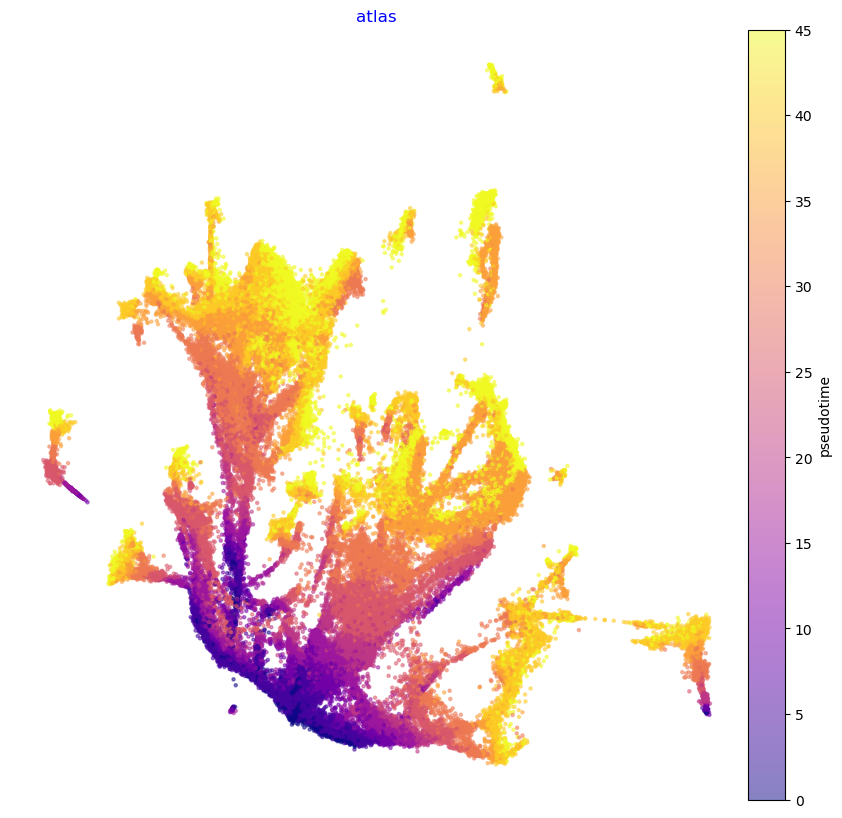

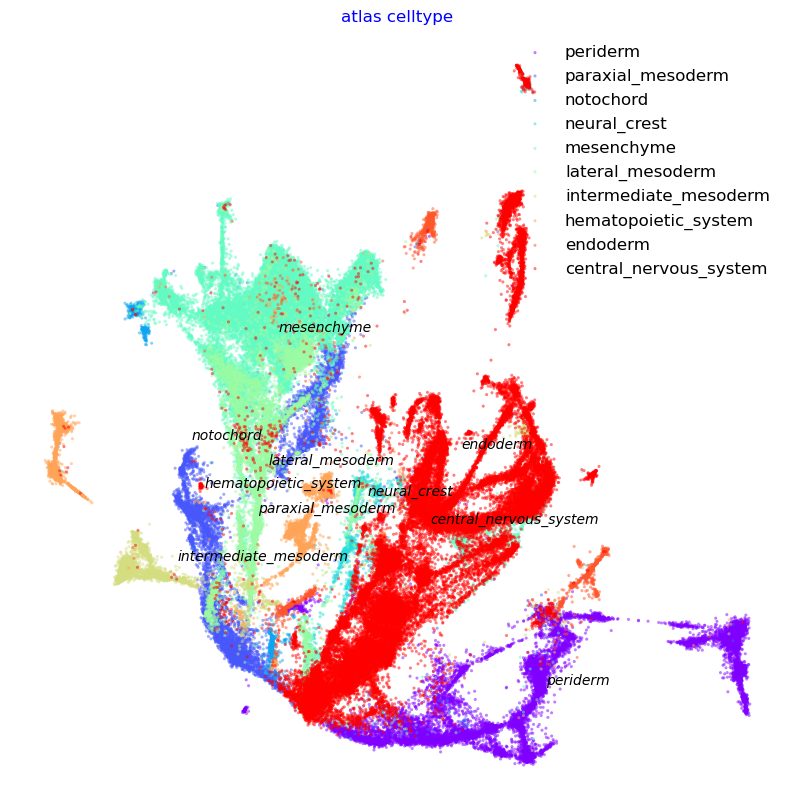

In [69]:
print(f'{datetime.now()}\tPlot Atlas Embedding')
f1, ax = via.plot_scatter(embedding=atlas_embedding, labels=time_point_numeric, cmap='plasma', s=5,
                          alpha=0.5, edgecolors='None',
                          title='atlas', text_labels=False)
f1.set_size_inches(10, 10)

f2, ax = via.plot_scatter(embedding=atlas_embedding, labels=coarse_cell_type, title='atlas celltype',
                          alpha=0.5, s=5)
f2.set_size_inches(10, 10)
plt.show()

### Atlas View Edges
1. Compute the edges and pass it onto the via_object to avoid recomputing each time you plot

In [70]:
print(f'{datetime.now()}\tStart Computing Atlas View')
dict_coarse = {'notochord':2.5, 'central_nervous_system':5.5,'neural_crest':4.5,'paraxial_mesoderm':0,'intermediate_mesoderm':1,'lateral_mesoderm':1.5,
                       'mesenchyme':2.0,'hematopoietic_system':0.5,'periderm':8,'endoderm':7}
decay = 0.55#0.7  # increasing decay increasing merging of edges
i_bw = 0.035#0.05  # increasing bw increases merging of edges
global_visual_pruning = 0.70#0.55
n_milestones =150

hammerbundle_dict = via.make_edgebundle_milestone(via_object=v0, n_milestones=n_milestones, decay=decay,
                                                  initial_bandwidth=i_bw,
                                                  global_visual_pruning=global_visual_pruning,
                                                  sc_labels_numeric=time_point_numeric)
v0.hammerbundle_milestone_dict = hammerbundle_dict  # make the hmbd in one shot to be used for all plots



2023-09-22 07:59:24.152472	Start Computing Atlas View
2023-09-22 07:59:24.152782	Start finding milestones


/home/user/anaconda3/envs/Via2Env_py10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


2023-09-22 07:59:34.506049	End milestones with 150
2023-09-22 07:59:35.893958	Recompute weights
2023-09-22 07:59:35.942158	pruning milestone graph based on recomputed weights
2023-09-22 07:59:35.944376	Graph has 1 connected components before pruning
2023-09-22 07:59:35.945770	Graph has 1 connected components after pruning
2023-09-22 07:59:35.946185	Graph has 1 connected components after reconnecting
2023-09-22 07:59:35.950008	regenerate igraph on pruned edges
2023-09-22 07:59:36.052003	Setting numeric label as time_series_labels or other sequential metadata for coloring edges
2023-09-22 07:59:36.319223	Making smooth edges


2023-09-22 07:59:42.840965	Plot Atlas View
inside add sc embedding second if


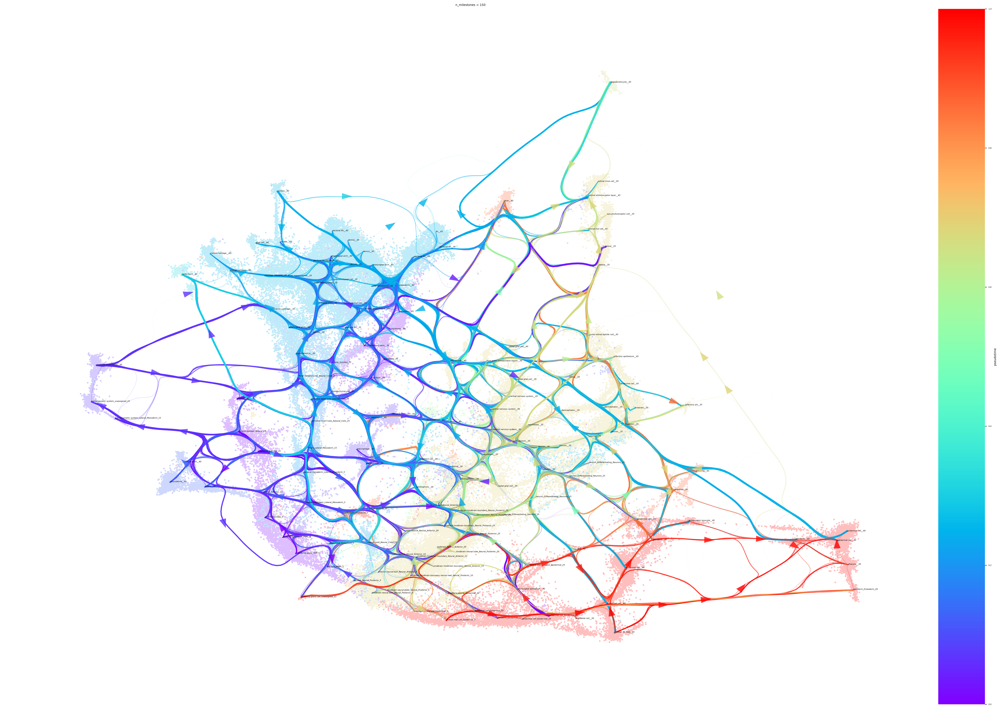

In [71]:
print(f'{datetime.now()}\tPlot Atlas View')
# color by tissue type, we 
color_dict = {'notochord': 2.5, 'central_nervous_system': 5.5, 'neural_crest': 4.5, 'paraxial_mesoderm': 0,
               'intermediate_mesoderm': 1, 'lateral_mesoderm': 1.5,
               'mesenchyme': 2.0, 'hematopoietic_system': 0.5, 'periderm': 8, 'endoderm': 7}

#color by major cell type
headwidth_bundle = 0.2
fig, ax = via.plot_atlas_view(via_object=v0, sc_labels=hybrid_cell_time, fontsize_labels=4, text_labels=True,
                                           add_sc_embedding=True, sc_scatter_alpha=0.25, scatter_size_sc_embedding=5,
                                           alpha_scatter=0.4, cmap='rainbow',
                                           linewidth_bundle=3, 
                                           sc_labels_expression=[color_dict[coarse_cell_type[i]] for i in
                                                                 range(len(v0.labels))],                             headwidth_bundle=headwidth_bundle)
fig.set_size_inches(35, 25)


plt.show()


inside add sc embedding second if


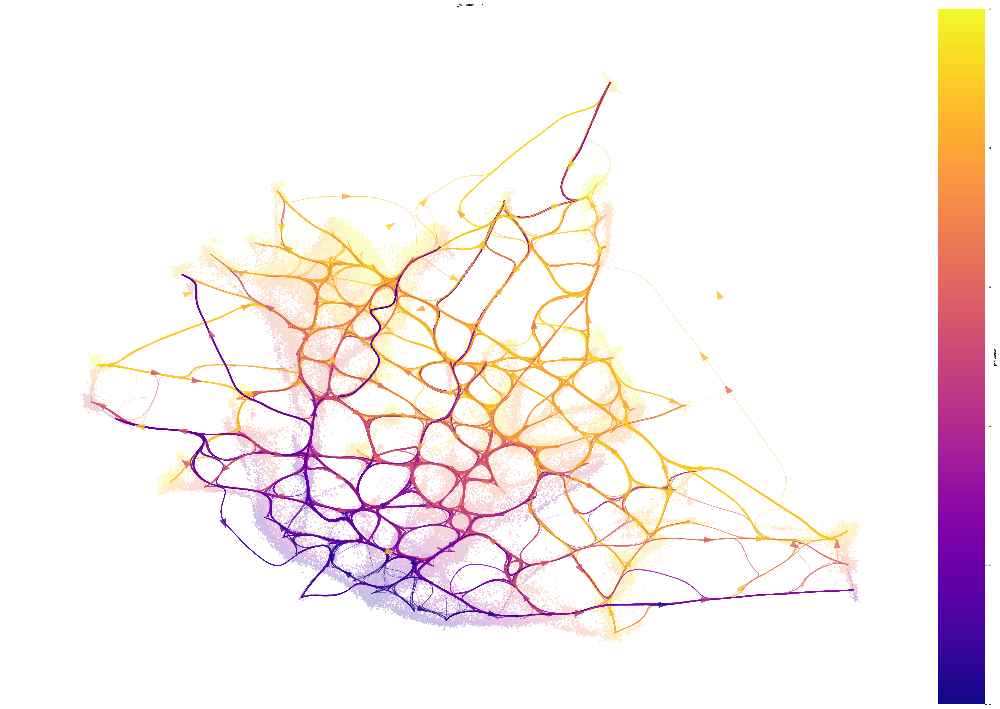

In [72]:

#if you want to color by categories (e.g. tissue type)
#autogenerate color_dict 
#color_dict = {}
#set_labels = list(set(labels))
#set_labels.sort(reverse=True)
#for index, value in enumerate(set_labels): color_dict[value] = index

#color by stage
fig2, ax2 = via.plot_atlas_view(via_object=v0, sc_labels=hybrid_cell_time, fontsize_labels=2, text_labels=False,
                                           add_sc_embedding=True, sc_scatter_alpha=0.25, scatter_size_sc_embedding=5,
                                           alpha_scatter=0.4, cmap='plasma',sc_labels_expression=time_point_numeric,
                                           linewidth_bundle=3, 
                                                headwidth_bundle=headwidth_bundle)
fig2.set_size_inches(35, 25)
